<a href="https://colab.research.google.com/github/josedanielisidororeyes/Anal-tica-Descriptiva-y-Predictiva/blob/main/Practica_20_Ejercicios_de_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


##Programación para Analítica Descriptiva y Predictiva
##Nombre de la tarea: Práctica #20: Ejercicios de EDA
##Grupo: A
##Autor: Jose Daniel Isidoro Reyes
##Matrícula: 261552
##Fecha:03 de octubre de 2025


# 1 | Descarga e importación de datos

In [141]:
import pandas as pd
df = pd.read_csv("/content/drive/MyDrive/Programación Analítica Predictiva/AirQuality.csv", sep  = ";")
# Selección de columnas relevantes
df =  df.iloc[:, :-2]
print("---Inspección de Filas ---")
df

---Inspección de Filas ---


,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,"2,6",1360.0,150.0,"11,9",1046.0,166.0,1056.0,113.0,1692.0,1268.0,"13,6","48,9","0,7578"
1,10/03/2004,19.00.00,2,1292.0,112.0,"9,4",955.0,103.0,1174.0,92.0,1559.0,972.0,"13,3","47,7","0,7255"
2,10/03/2004,20.00.00,"2,2",1402.0,88.0,"9,0",939.0,131.0,1140.0,114.0,1555.0,1074.0,"11,9","54,0","0,7502"
3,10/03/2004,21.00.00,"2,2",1376.0,80.0,"9,2",948.0,172.0,1092.0,122.0,1584.0,1203.0,"11,0","60,0","0,7867"
4,10/03/2004,22.00.00,"1,6",1272.0,51.0,"6,5",836.0,131.0,1205.0,116.0,1490.0,1110.0,"11,2","59,6","0,7888"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9468,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Antes de comenzar con el análisis exploratorio de los datos,  verificamos que todas las columnas tengo el tipo de dato correcto.

In [142]:
print("---Tipo de datos por columna---\n")
df.info()

---Tipo de datos por columna---

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         9357 non-null   object 
 3   PT08.S1(CO)    9357 non-null   float64
 4   NMHC(GT)       9357 non-null   float64
 5   C6H6(GT)       9357 non-null   object 
 6   PT08.S2(NMHC)  9357 non-null   float64
 7   NOx(GT)        9357 non-null   float64
 8   PT08.S3(NOx)   9357 non-null   float64
 9   NO2(GT)        9357 non-null   float64
 10  PT08.S4(NO2)   9357 non-null   float64
 11  PT08.S5(O3)    9357 non-null   float64
 12  T              9357 non-null   object 
 13  RH             9357 non-null   object 
 14  AH             9357 non-null   object 
dtypes: float64(8), object(7)
memory usage: 1.1+ MB


Como podemos observar la columna Date y Time no están formateadas como fecha. Las columnas CO(GT), C6H6(GT), T, RH, y AH se encuentran formateadas como texto cuando deberían ser valores númericos, además de presentar el problema de usar la coma para décimales en lugar del punto. De igual identificamos otro reto importante, hay varios filas con NaN.

In [143]:
# Combinamos Date y Time para tener una columna DateTime
df["DateTime"] =  df["Date"]  + ' ' +  df['Time']

df["DateTime"] =  pd.to_datetime(
    df["DateTime"],
    format = "%d/%m/%Y %H.%M.%S"
)
# Eliminamos las columnas Date y Time debido a que son redundante
df =  df.drop(["Date", "Time"], axis =  1)

# Reemplazamos las comas por puntos para poder realizar la transformación a números
df["CO(GT)"] =  df["CO(GT)"].str.replace(',', '.', regex =  False).astype("float")
df["C6H6(GT)"] =  df["C6H6(GT)"].str.replace(',', '.', regex =  False).astype("float")
df["T"] =  df["T"].str.replace(',', '.', regex =  False).astype("float")
df["RH"] =  df["RH"].str.replace(',', '.', regex =  False).astype("float")
df["AH"] =  df["AH"].str.replace(',', '.', regex =  False).astype("float")

Para trabajar con una conjunto de datos limpio, se combinan las columnas Date y Time para crear una columna DateTime. Por otro lado, las comas son sustituidas por punto para poder realizar la transformación a tipo flotante sin errores.

In [144]:
print("---Tipo de datos por columna después de la limpieza---\n")
df.info()

---Tipo de datos por columna después de la limpieza---

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   CO(GT)         9357 non-null   float64       
 1   PT08.S1(CO)    9357 non-null   float64       
 2   NMHC(GT)       9357 non-null   float64       
 3   C6H6(GT)       9357 non-null   float64       
 4   PT08.S2(NMHC)  9357 non-null   float64       
 5   NOx(GT)        9357 non-null   float64       
 6   PT08.S3(NOx)   9357 non-null   float64       
 7   NO2(GT)        9357 non-null   float64       
 8   PT08.S4(NO2)   9357 non-null   float64       
 9   PT08.S5(O3)    9357 non-null   float64       
 10  T              9357 non-null   float64       
 11  RH             9357 non-null   float64       
 12  AH             9357 non-null   float64       
 13  DateTime       9357 non-null   datetime64[ns]
dtypes: datetime64[ns

Finalmente eliminamos las filas que no tienen datos.

In [145]:
# Eliminamos todas las filas que no tengan datos
df =  df.dropna(how  = "all")
print("---Inspección de Filas después de la limpieza")
df

---Inspección de Filas después de la limpieza


,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,DateTime
0,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,2004-03-10 18:00:00
1,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,2004-03-10 19:00:00
2,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,2004-03-10 20:00:00
3,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,2004-03-10 21:00:00
4,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,2004-03-10 22:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9352,3.1,1314.0,-200.0,13.5,1101.0,472.0,539.0,190.0,1374.0,1729.0,21.9,29.3,0.7568,2005-04-04 10:00:00
9353,2.4,1163.0,-200.0,11.4,1027.0,353.0,604.0,179.0,1264.0,1269.0,24.3,23.7,0.7119,2005-04-04 11:00:00
9354,2.4,1142.0,-200.0,12.4,1063.0,293.0,603.0,175.0,1241.0,1092.0,26.9,18.3,0.6406,2005-04-04 12:00:00
9355,2.1,1003.0,-200.0,9.5,961.0,235.0,702.0,156.0,1041.0,770.0,28.3,13.5,0.5139,2005-04-04 13:00:00


# 2 | Análisis Exploratorio de Datos Completo

## Descripción de los datos (medias, medianas, desviaciones estándar, etc)

In [146]:
# Solo considera valores númericos
# Para incluir todas las variables se necesita especificar el argumento "include = all"
df.select_dtypes(include  = "number").describe()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
count,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000
mean,-34.207524,1048.990061,-159.090093,1.865683,894.595276,168.616971,794.990168,58.148873,1391.479641,975.072032,9.778305,39.485380,-6.837604
std,77.657170,329.832710,139.789093,41.380206,342.333252,257.433866,321.993552,126.940455,467.210125,456.938184,43.203623,51.216145,38.976670
min,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000
25%,0.600000,921.000000,-200.000000,4.000000,711.000000,50.000000,637.000000,53.000000,1185.000000,700.000000,10.900000,34.100000,0.692300
50%,1.500000,1053.000000,-200.000000,7.900000,895.000000,141.000000,794.000000,96.000000,1446.000000,942.000000,17.200000,48.600000,0.976800
75%,2.600000,1221.000000,-200.000000,13.600000,1105.000000,284.000000,960.000000,133.000000,1662.000000,1255.000000,24.100000,61.900000,1.296200
max,11.900000,2040.000000,1189.000000,63.700000,2214.000000,1479.000000,2683.000000,340.000000,2775.000000,2523.000000,44.600000,88.700000,2.231000




*   PT08.S1(CO) parece estar bien distribuida, ya que la media y mediana son similares, 1048.99 y 1053, respectivamente.
*   NMHC(GT)	llama la atención que la media sea negativa, lo cual puede deberse a errores o la manera en la que son representados los valores faltantes en este conjunto de datos, ya que todas las variables tienen como valor mínimo -200.
*   PT08.S2(NMHC) parece estar bien distribuida, ya que la media y la mediana son similares, 894.59  y 895, respectivamente.
*   NOx(GT) sugiere la presencia de valores atipicos, ya que la media y la mediana divergen, 168.61 y 141, respectivamente. Debido a que la media es mayor la mediana, se infiere que la variable exhibe un sesgo positivo debido a la presencia de valores atípicos.
*   PT08.S3(NOx) parece estar bien distribuida, la media y mediana son bastante similares, 	794.99 y 794, respectivamente. Aunque con la presencia de algunos valores atípicos como 2683.
*   NO2(GT) sugiere que la variable no está bien distribuida, vemos que la media y mediana son muy diferentes, 58.14 y 96, respectivamente. Dado que la media es menor a la mediana, se infiere que la variable exhibe sesgo negativo.
*   PT08.S4(NO2) parece no estar bien distribuida. El hecho de que la media sea menor a la media,  sugiere que la variable exhibe sesgo negativo debido a la presencia de valores atípicos.
*   PT08.S5(O3) parece no estar bien distribuida, ya que la media es mayor a la mediana, lo cual sugiere la presencia de sesgo positivo debido a presencia de valores atípicos.
*   Las variables T y RH parecen no estar bien distribuidas, ya que la media es menor a la mediana, se infiere que las variables puede tener un sesgo a la izquierda.
* Finalmente, la variable tiene una media negativa, lo cual sugiere es otro errores. El análisis por quantiles indica que la variable tiene valores pequeños, por lo que valores atípicos pueden estar distorcionando la media.   











Revisando la documentación del conjunto de datos, la sospecha es confirmada. Los valores faltantes son codificados como -200. Una vez identificados valores faltantes se remplazan por np.nan.
**Referencia**:
https://archive.ics.uci.edu/dataset/360/air+quality

In [147]:
# Remplazado de valores faltantes
import numpy as np
df.replace(-200, np.nan, inplace  =  True)

## Histogramas para las columnas númericas

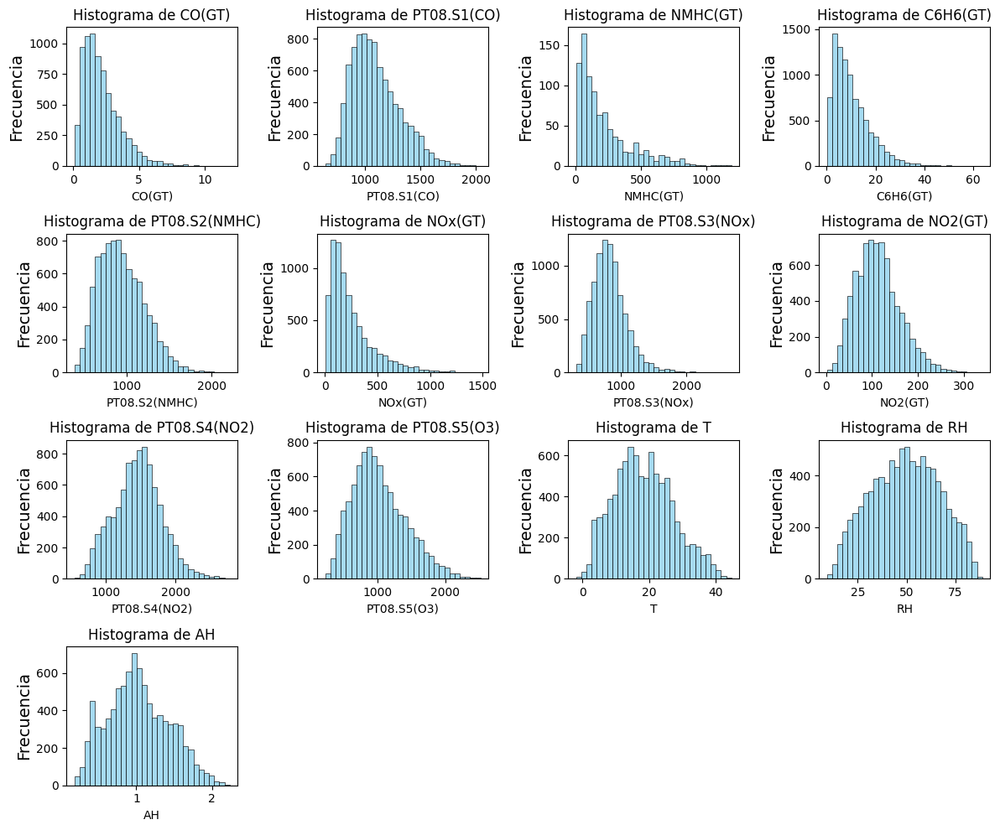

In [148]:
import matplotlib.pyplot as plt
import seaborn as sns
# Selección de columnas númericas
columnas_numericas =  df.select_dtypes(include  = "number").columns

# Creación de histogramas para cada columna
plt.figure(figsize =  (12, 10))
for i, col in enumerate(columnas_numericas , 1):
    plt.subplot(4, 4, i)
    sns.histplot(df[col], kde =  False, bins =  30, color  = "skyblue")
    plt.title(f"Histograma de {col}", fontsize =  12)
    plt.xlabel(col, fontsize =  10)
    plt.ylabel("Frecuencia", fontsize =  14)

plt.tight_layout()
plt.show()



*   CO(GT) no tiene una distribución normal, de hecho muestra una distribución sesgada hacia la derecha.
*   PT08.S1(CO) exhibe el mismo compartamiento que la variable anterior con una distribuciuón sesgada hacia la derecha.
*   En general todas las variables exhiben una distribución sesgada la derecha, con excepción de las varaibles AH, RH, T, y PT08.S4(NO2) que exhiben una distribución más simétricas, sin embargo, no parecen estar distribuidas como una normal.










## Obtención del día de la semana y realización de gráfico de barras

/tmp/ipython-input-1432532218.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x = "Semana", data  =  df, palette =  "viridis")


Text(0.5, 0, 'Frecuencia')

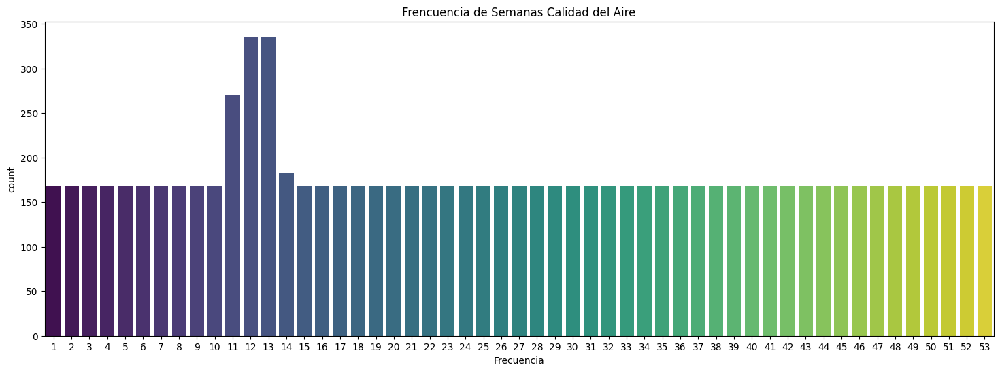

In [149]:
# Obtención del día de la semana
import seaborn as sns
df["Semana"] =  df["DateTime"].dt.isocalendar().week
plt.figure(figsize =  (18, 6))
sns.countplot(x = "Semana", data  =  df, palette =  "viridis")
plt.title("Frencuencia de Semanas Calidad del Aire")
plt.xlabel("Frecuencia")

Como se puede observar el mayor número de registros se encuentran entre las semanas 11, 12, 13, 14. Llama la atención la existencia de registros en la semana 53, lo cual puede ser atruibuible a los año bisiestos.:

# Boxplot para detección de outliers

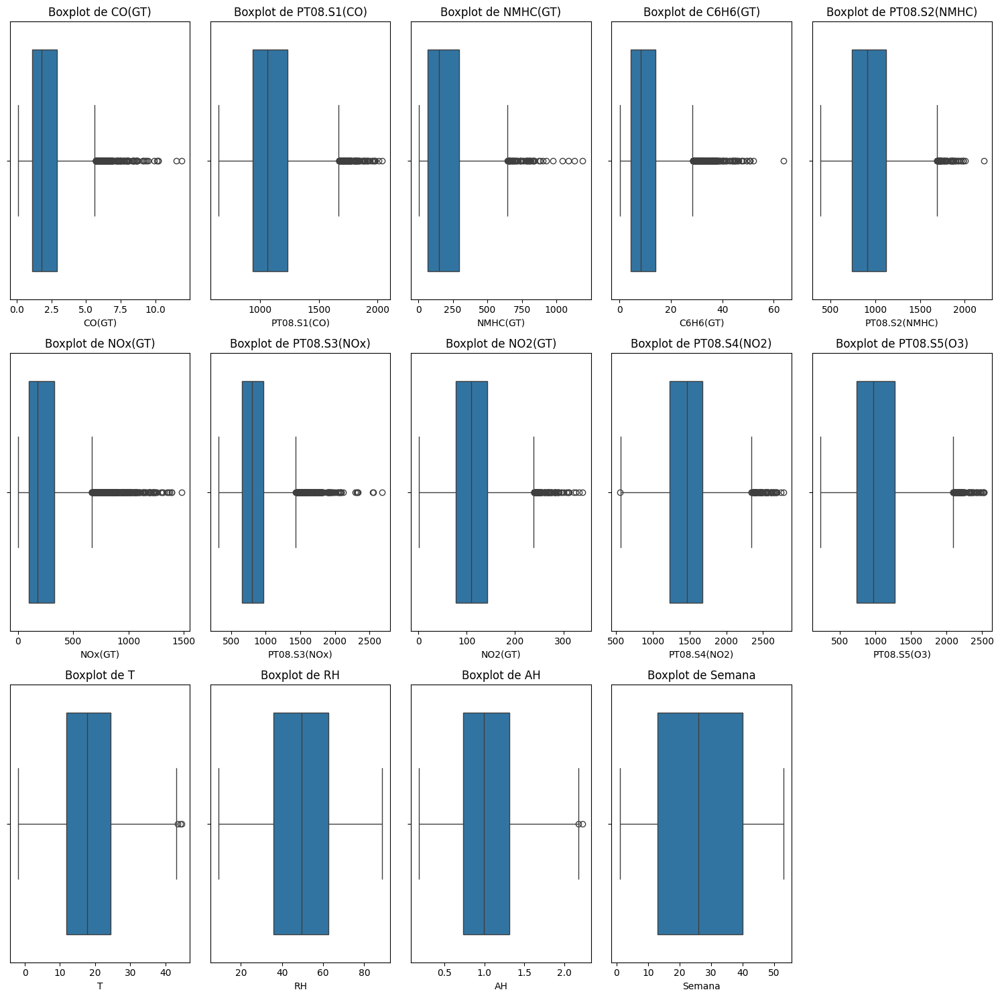

In [150]:
num_cols  =  df.select_dtypes(include  =  "number").columns
plt.figure(figsize =  (15, 15))

# Creación de boxplots por columna
for i, col in enumerate(num_cols, 1):
    plt.subplot(3, 5, i)
    sns.boxplot(x =  df[col])
    plt.title(f"Boxplot de {col}")
plt.tight_layout()
plt.show()

Como se puede observar la mayoría de variables presentan valores atipicos con excepción de las variables T, RH, AH, y Semana que tienen pocos o ningun valor atípico.

## Heatmap de Correlaciones

---Matriz de Correlaciones---
                 CO(GT)  PT08.S1(CO)  NMHC(GT)  C6H6(GT)  PT08.S2(NMHC)  \
CO(GT)         1.000000     0.879288  0.889734  0.931078       0.915514   
PT08.S1(CO)    0.879288     1.000000  0.790670  0.883795       0.892964   
NMHC(GT)       0.889734     0.790670  1.000000  0.902559       0.877696   
C6H6(GT)       0.931078     0.883795  0.902559  1.000000       0.981950   
PT08.S2(NMHC)  0.915514     0.892964  0.877696  0.981950       1.000000   
NOx(GT)        0.795028     0.713654  0.812685  0.718839       0.704435   
PT08.S3(NOx)  -0.703446    -0.771938 -0.771135 -0.735744      -0.796703   
NO2(GT)        0.683343     0.641529  0.731193  0.614474       0.646245   
PT08.S4(NO2)   0.630703     0.682881  0.853267  0.765731       0.777254   
PT08.S5(O3)    0.854182     0.899324  0.766723  0.865689       0.880578   
T              0.022109     0.048627  0.391587  0.198956       0.241373   
RH             0.048890     0.114606 -0.191454 -0.061681      -0.09038

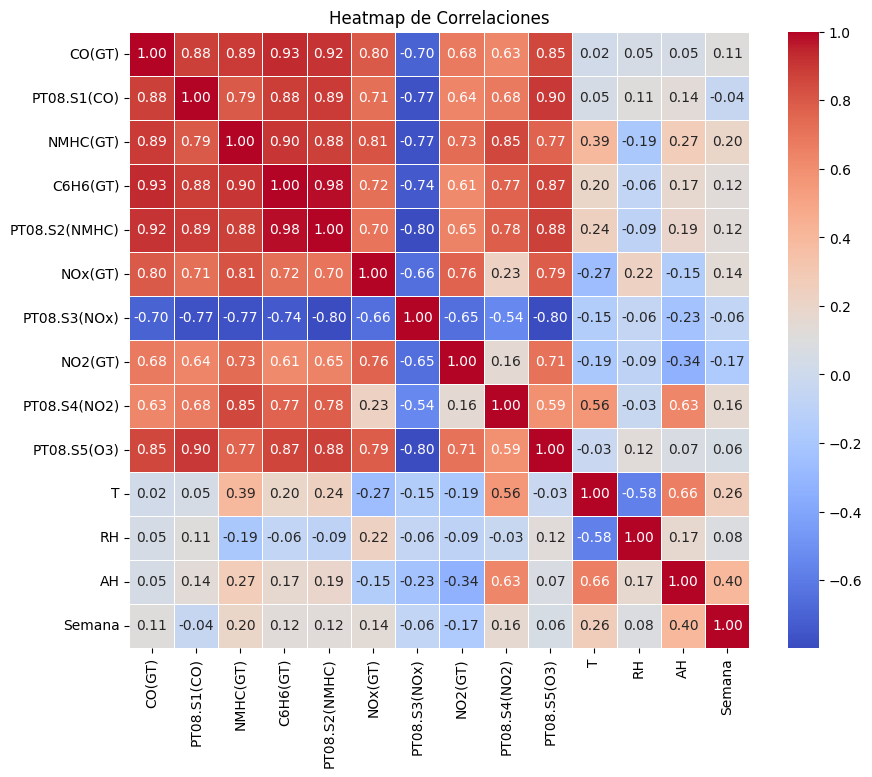

In [151]:
num_cols =  df.select_dtypes(include  = "number")

# Matriz de correlaciones
corr_matrix =  num_cols.corr()

#
print("---Matriz de Correlaciones---")
print(corr_matrix)


# Visualizar la matriz de correlación con un heatmap
plt.figure(figsize =  (10, 8))
sns.heatmap(corr_matrix, annot = True, cmap =  "coolwarm",  fmt = ".2f", linewidth =  0.5)
plt.title("Heatmap de Correlaciones")
plt.show()

Se observa que la variable CO(GT) tiene un correlación positiva fuerte con las variables PT08.S3(NOx), NMHC(GT), C6H6(GT), PT08.S4(NO2), NOx(GT), por mencionar algunas, lo cual indica que se mueven en la misma dirección. En contraste, encontramos correalaciones fuertes negatives entre  PT08.S3(NOx) y PT08.S5(O3), 'CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)',  y 'C6H6(GT)', por mencionar algunas, lo cual sugiere que cuando una aumenta las demás se mueven en dirección contraria.

# Pairplot

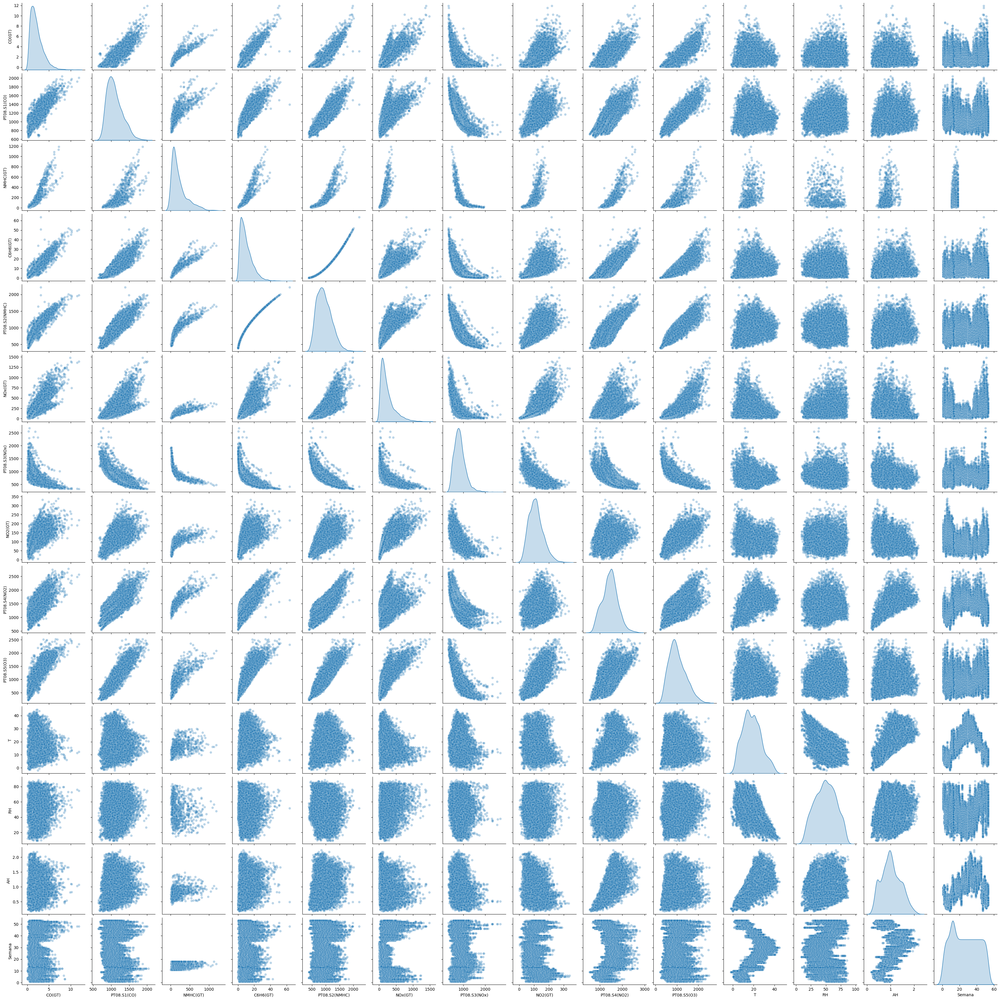

In [152]:
num_cols  =  df.select_dtypes(include = "number")
sns.pairplot(num_cols, plot_kws = {'alpha': 0.3}, diag_kind = 'kde')
plt.show()

Del gráfico anterior se pueden indentificar algunas relaciones lineales como la de CO(GT) y C6H6(GT), algunas relaciones cuadráticas como C6H6(GT) y NMHC(GT), e incluso exponencial como por ejemplo, PT08.S5(O3) y NMHC(GT), lo cual nos da una idea general de como modelar las relaciones entre las variables.

# Pruebas de Normalidad

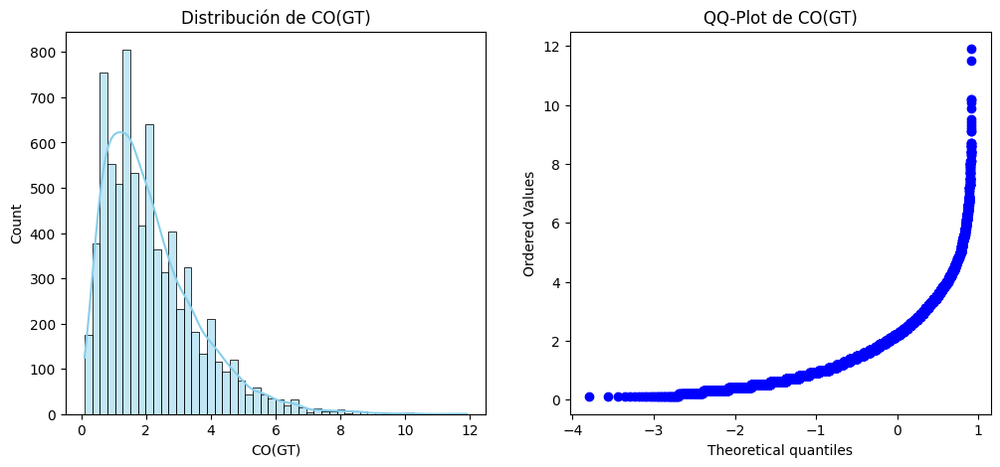


Pruebas de normalidad para la columna: CO(GT)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


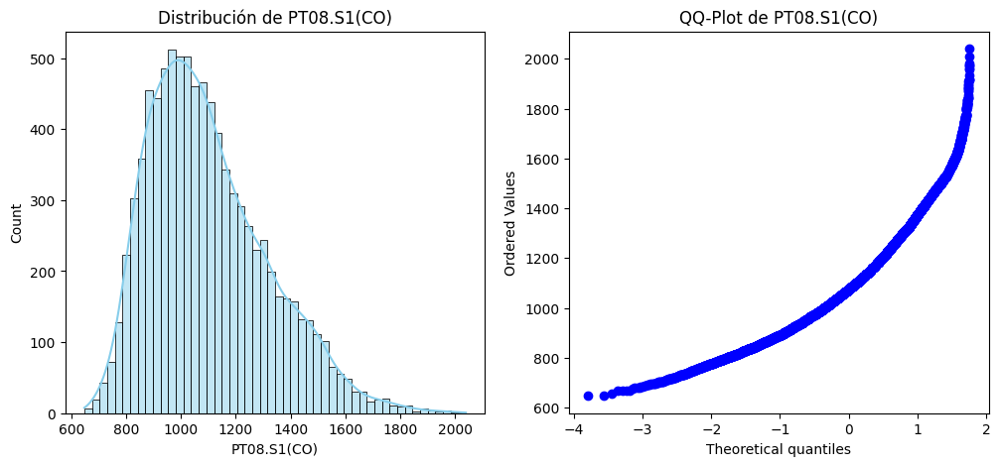


Pruebas de normalidad para la columna: PT08.S1(CO)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


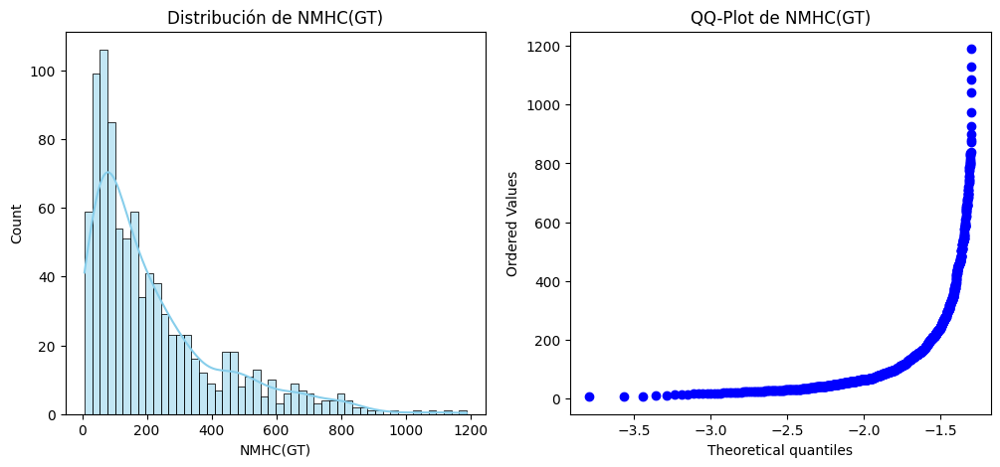


Pruebas de normalidad para la columna: NMHC(GT)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


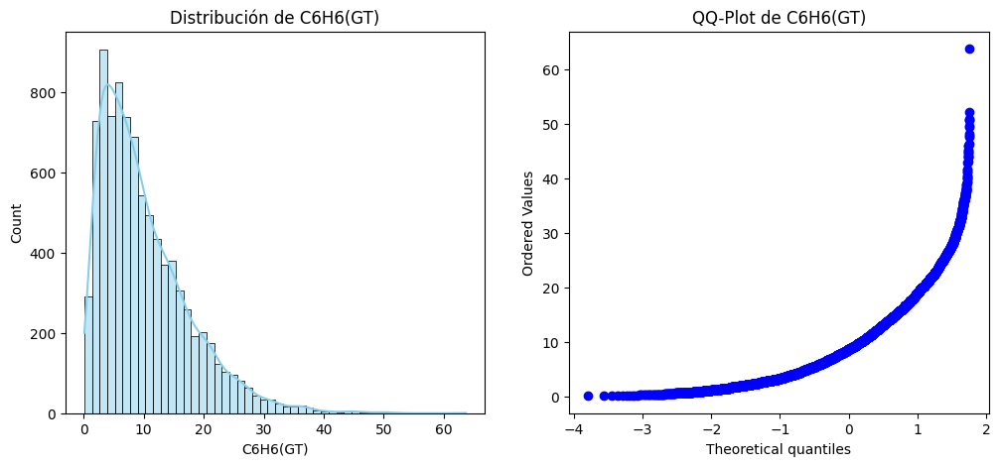


Pruebas de normalidad para la columna: C6H6(GT)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


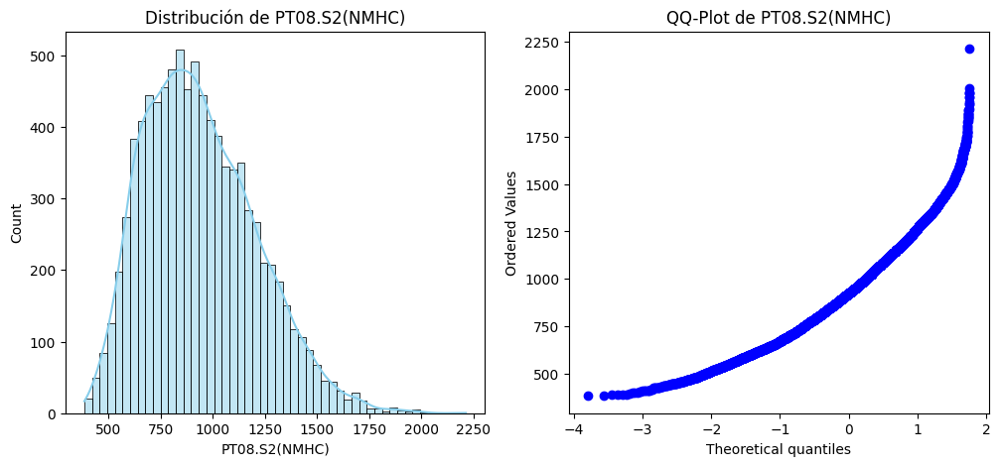


Pruebas de normalidad para la columna: PT08.S2(NMHC)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


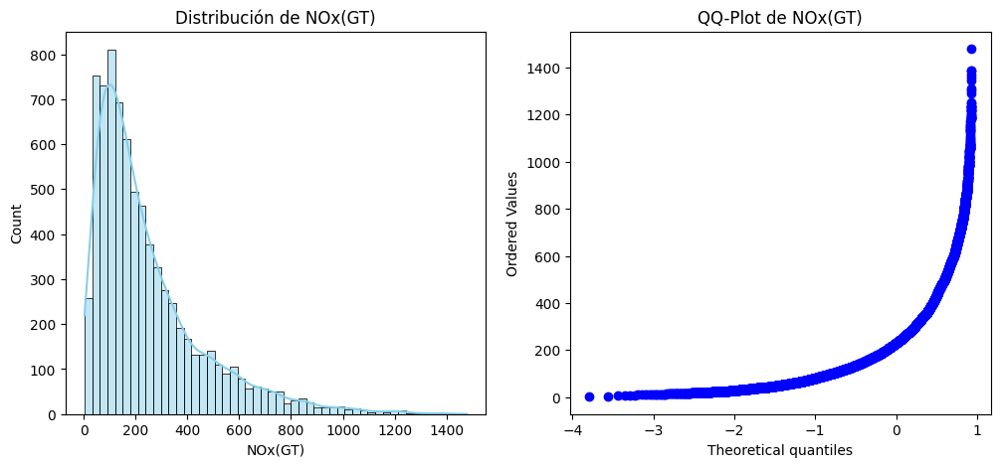


Pruebas de normalidad para la columna: NOx(GT)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


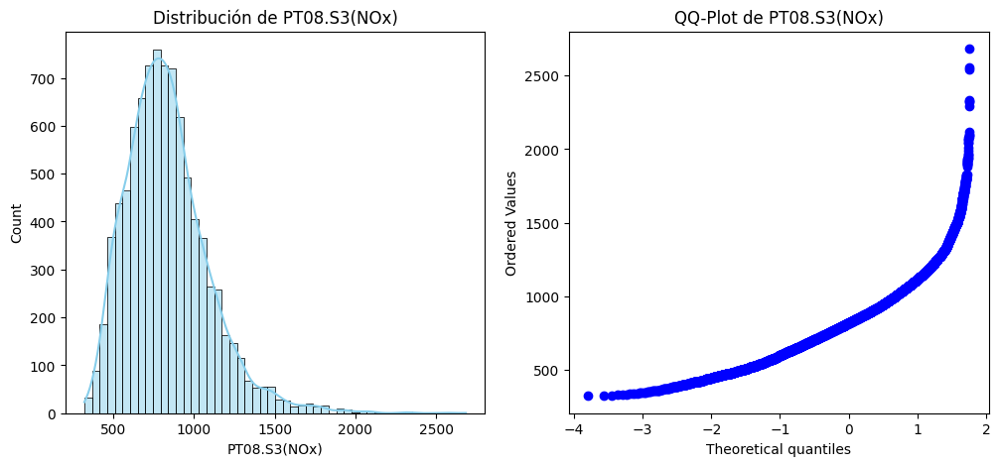


Pruebas de normalidad para la columna: PT08.S3(NOx)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


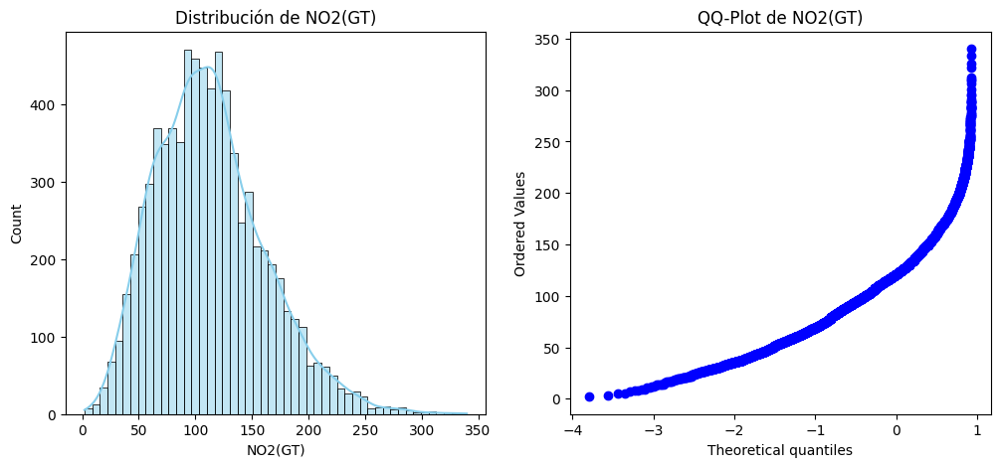


Pruebas de normalidad para la columna: NO2(GT)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


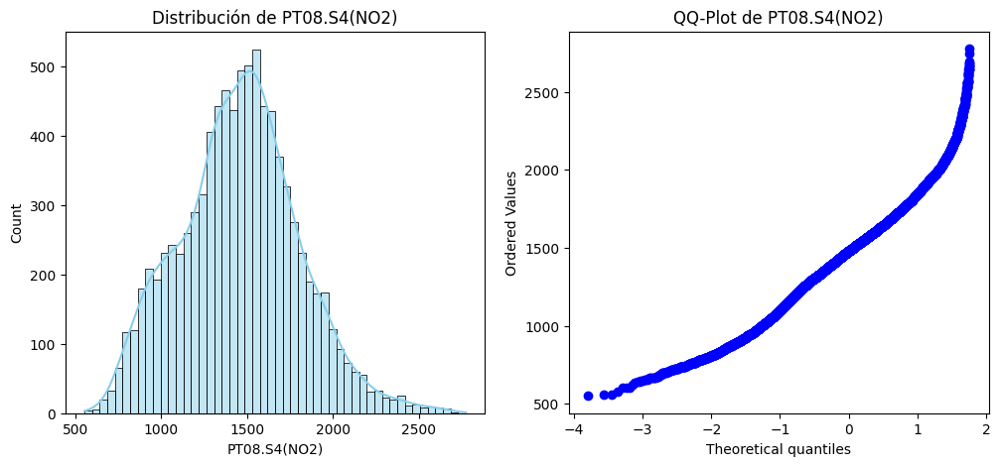


Pruebas de normalidad para la columna: PT08.S4(NO2)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


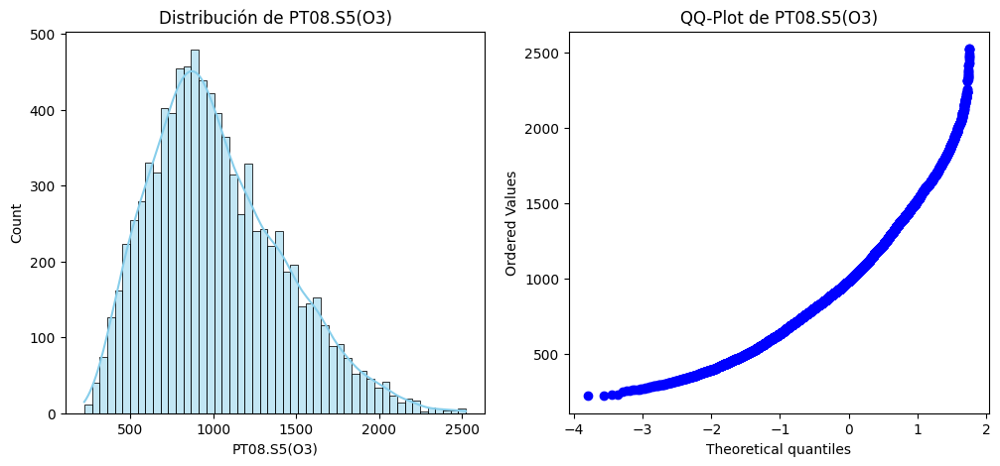


Pruebas de normalidad para la columna: PT08.S5(O3)
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


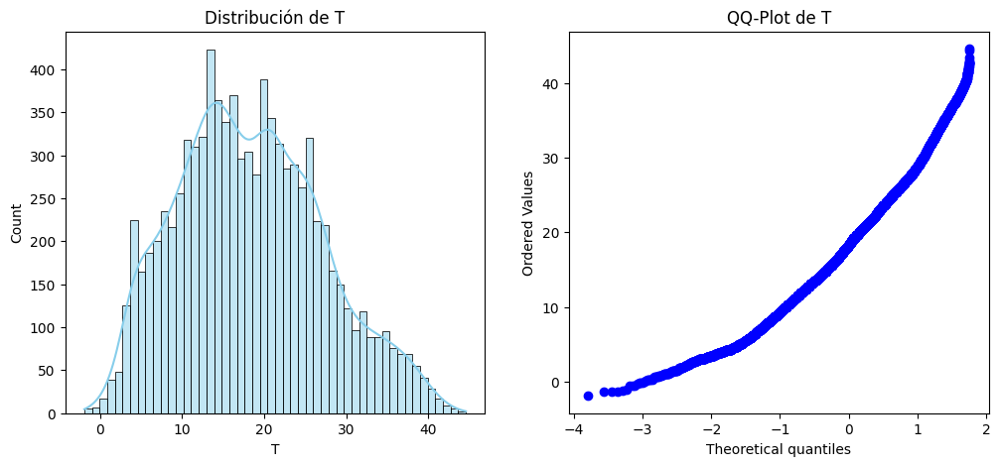


Pruebas de normalidad para la columna: T
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


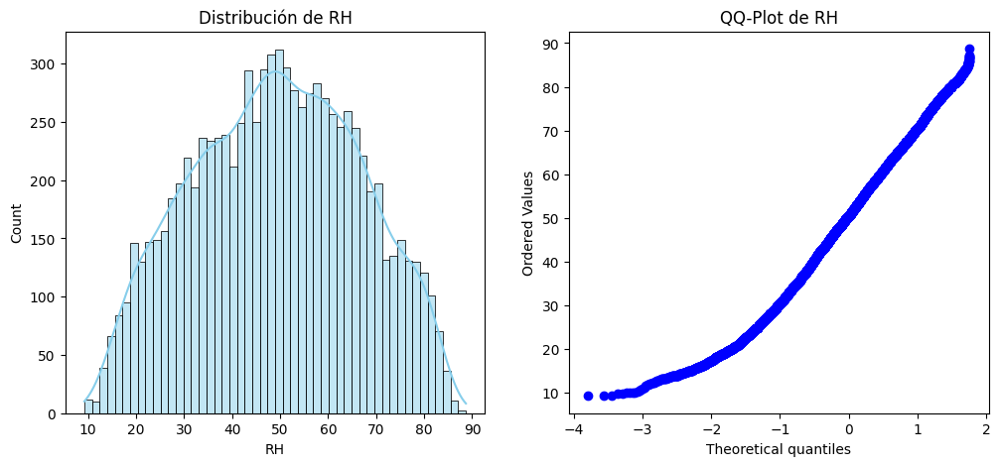


Pruebas de normalidad para la columna: RH
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


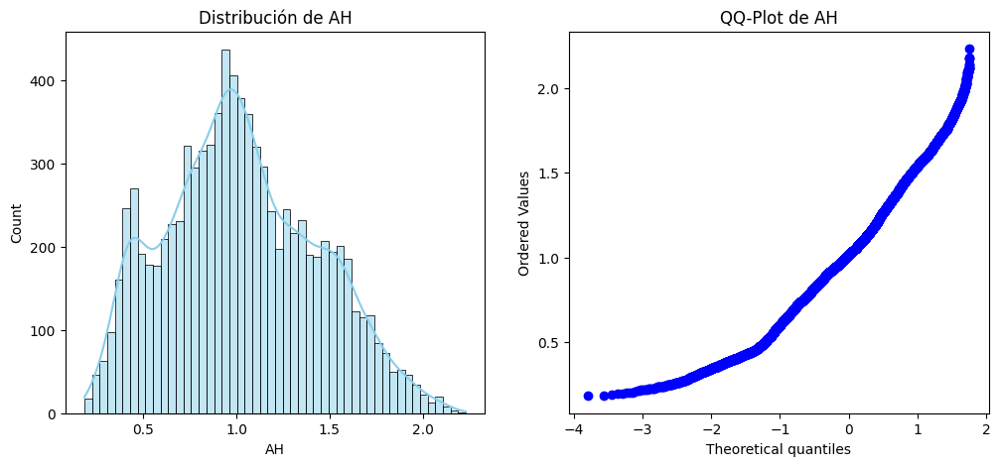


Pruebas de normalidad para la columna: AH
Shapiro-Wilk Test: p-valor = nan
Kolmogorov-Smirnov Test: p-valor = nan
Anderson-Darling Test: Estadístico = nan
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = nan


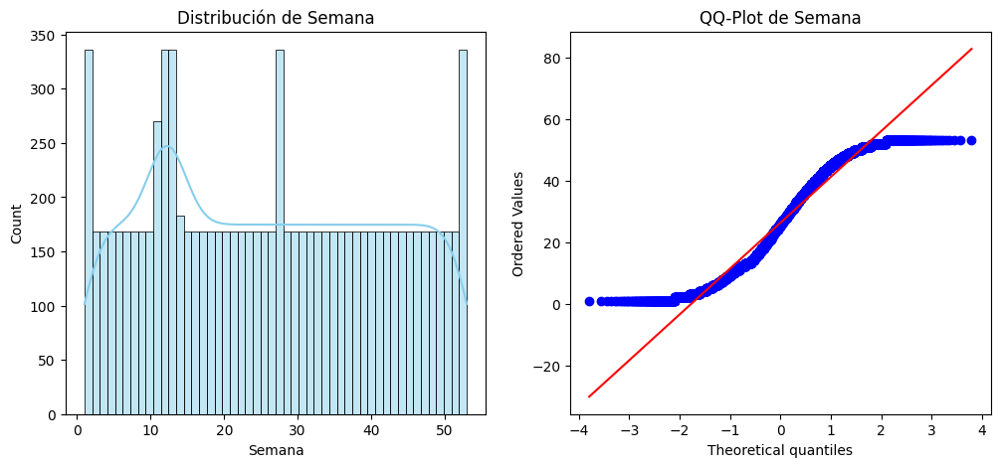


Pruebas de normalidad para la columna: Semana
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 124.17234
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


In [153]:
import scipy.stats as stats
import numpy as np

numeric_columns  =  df.select_dtypes(include  = "number")

# Función para realizar pruebas de normalidad
def normality_tests(data, column_name):
    print(f"\nPruebas de normalidad para la columna: {column_name}")

    # Prueba de Shapiro-Wilk
    shapiro_test = stats.shapiro(data.sample(min(5000, len(data)), random_state=42))  # Muestra de 5000 para evitar problemas de cómputo
    print(f"Shapiro-Wilk Test: p-valor = {shapiro_test.pvalue:.5f}")

    # Prueba de Kolmogorov-Smirnov
    ks_test = stats.kstest(data, 'norm', args=(data.mean(), data.std()))
    print(f"Kolmogorov-Smirnov Test: p-valor = {ks_test.pvalue:.5f}")

    # Prueba de Anderson-Darling
    anderson_test = stats.anderson(data, dist='norm')
    print(f"Anderson-Darling Test: Estadístico = {anderson_test.statistic:.5f}")
    for i in range(len(anderson_test.critical_values)):
        sl, cv = anderson_test.significance_level[i], anderson_test.critical_values[i]
        if anderson_test.statistic < cv:
            print(f"  Al nivel de significancia {sl}%, los datos parecen normales.")
        else:
            print(f"  Al nivel de significancia {sl}%, los datos NO parecen normales.")

    # Prueba de D'Agostino-Pearson
    dagostino_test = stats.normaltest(data)
    print(f"D'Agostino-Pearson Test: p-valor = {dagostino_test.pvalue:.5f}")

# Función para graficar histograma y QQ-Plot
def plot_distribution(data, column_name):
    plt.figure(figsize=(12, 5))

    # Histograma
    plt.subplot(1, 2, 1)
    sns.histplot(data, bins=50, kde=True, color="skyblue")
    plt.title(f"Distribución de {column_name}")

    # QQ-Plot
    plt.subplot(1, 2, 2)
    stats.probplot(data, dist="norm", plot=plt)
    plt.title(f"QQ-Plot de {column_name}")

    plt.show()

# Aplicar pruebas de normalidad y gráficos a cada columna numérica
for column in numeric_columns:
    data = df[column]
    plot_distribution(data, column)
    normality_tests(data, column)


Todas las pruebas estadísticas de normalidad sugieren que no hay evidencia de que los datos se distribuyan normalmente.

#3 Identificar y tratar los datos faltantes utilizando técnicas como imputación por media, mediana o moda, o eliminación de filas/columnas según sea apropiado.



In [154]:
df.isnull().mean()

,0
CO(GT),0.179865
PT08.S1(CO),0.039115
NMHC(GT),0.902319
C6H6(GT),0.039115
PT08.S2(NMHC),0.039115
NOx(GT),0.175163
PT08.S3(NOx),0.039115
NO2(GT),0.175484
PT08.S4(NO2),0.039115
PT08.S5(O3),0.039115


In [155]:
del df["NMHC(GT)"]

columnas_a_imputar =  ['DateTime', 'CO(GT)', 'PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)',
       'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
       'T', 'RH', 'AH']

media  =  df[columnas_a_imputar].mean()


df = df[columnas_a_imputar].fillna(media)

print("---Verificación de valores faltantes despues de la imputación---")
print(df[columnas_a_imputar].isnull().mean())


---Verificación de valores faltantes despues de la imputación---
DateTime         0.0
CO(GT)           0.0
PT08.S1(CO)      0.0
C6H6(GT)         0.0
PT08.S2(NMHC)    0.0
NOx(GT)          0.0
PT08.S3(NOx)     0.0
NO2(GT)          0.0
PT08.S4(NO2)     0.0
PT08.S5(O3)      0.0
T                0.0
RH               0.0
AH               0.0
dtype: float64


Se realiza imputación de valores faltantes con el promedio y se elimina NMHC(GT)	ya que tiene más del 90% de valores faltantes.

#4 Repetir el EDA con el tratamienrto de valores faltantes

In [156]:
def limpiar_atipicos_iqr_capping(df):

    df_tratado = df.copy()

    columnas_numericas = df_tratado.select_dtypes(include=np.number).columns

    for columna in columnas_numericas:

        Q1 = df_tratado[columna].quantile(0.25)
        Q3 = df_tratado[columna].quantile(0.75)
        IQR = Q3 - Q1

        limite_superior = Q3 + 1.5 * IQR
        limite_inferior = Q1 - 1.5 * IQR

        df_tratado[columna] = np.where(
            df_tratado[columna] > limite_superior,
            limite_superior,
            np.where(
                df_tratado[columna] < limite_inferior,
                limite_inferior,
                df_tratado[columna]
            )
        )

    return df_tratado


df =  limpiar_atipicos_iqr_capping(df)

# 4 Repetir el EDA después del tratamiento de datos faltantes y comparar los resultados

In [157]:
df.columns

Index(['DateTime', 'CO(GT)', 'PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)',
       'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
       'T', 'RH', 'AH'],
      dtype='object')

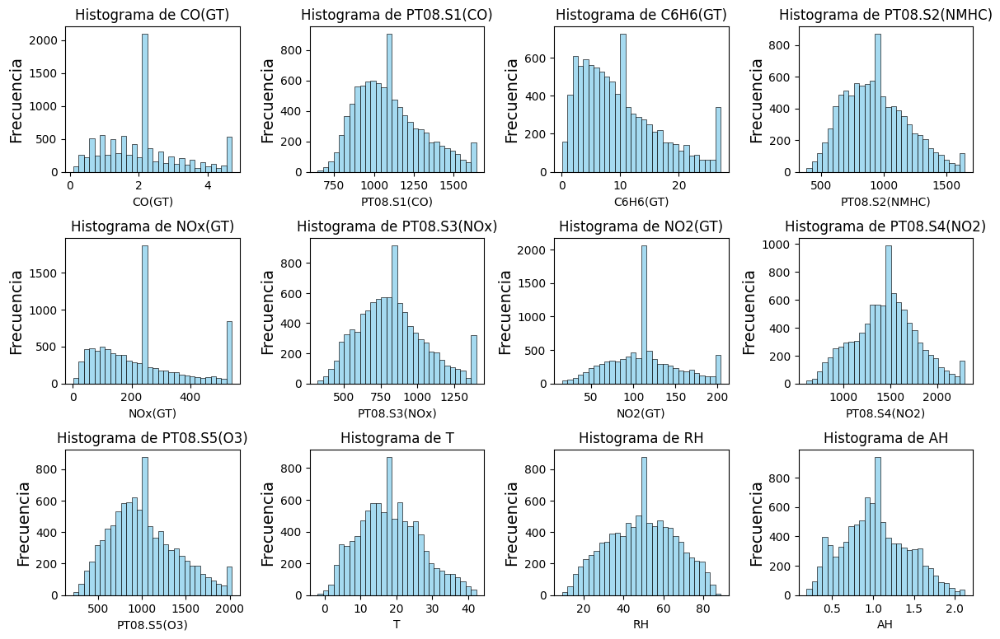

/tmp/ipython-input-575545216.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x = "Semana", data  =  df, palette =  "viridis")


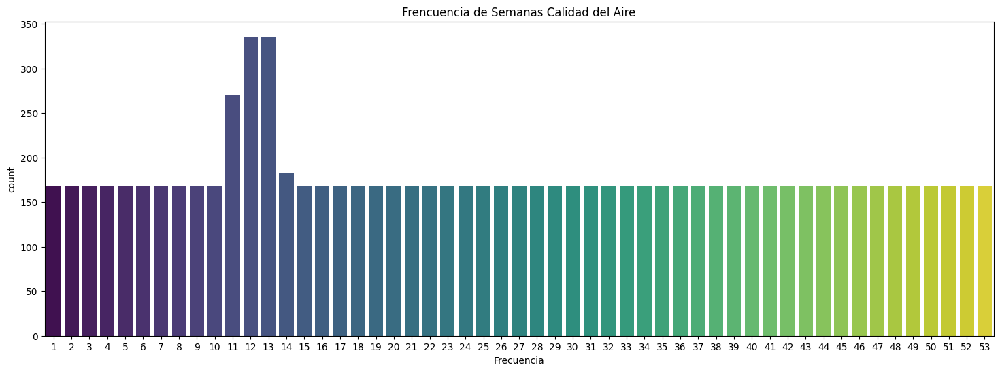

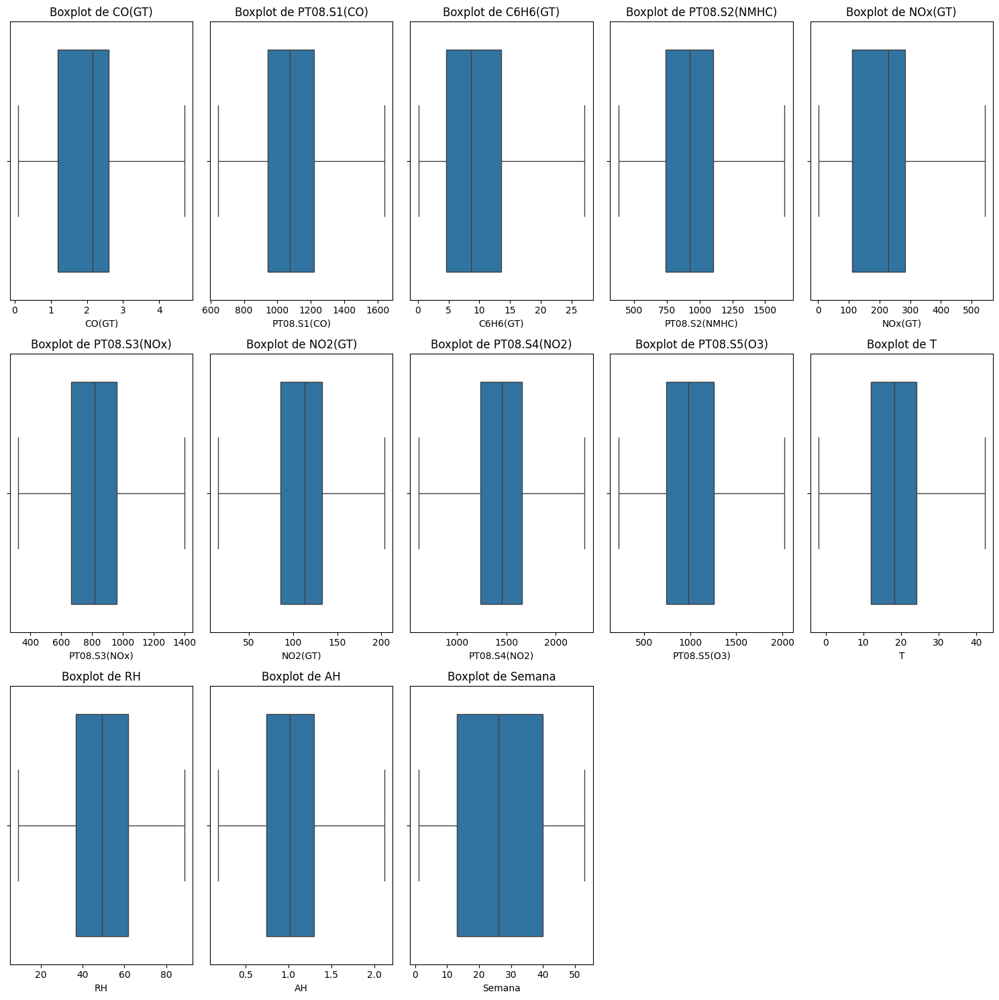

---Matriz de Correlaciones---
                 CO(GT)  PT08.S1(CO)  C6H6(GT)  PT08.S2(NMHC)   NOx(GT)  \
CO(GT)         1.000000     0.776486  0.817234       0.806988  0.732731   
PT08.S1(CO)    0.776486     1.000000  0.888712       0.893025  0.621166   
C6H6(GT)       0.817234     0.888712  1.000000       0.988611  0.611390   
PT08.S2(NMHC)  0.806988     0.893025  0.988611       1.000000  0.608027   
NOx(GT)        0.732731     0.621166  0.611390       0.608027  1.000000   
PT08.S3(NOx)  -0.671874    -0.810777 -0.792284      -0.829927 -0.641847   
NO2(GT)        0.660833     0.574006  0.559273       0.574089  0.788933   
PT08.S4(NO2)   0.558778     0.676338  0.764931       0.773560  0.183142   
PT08.S5(O3)    0.767866     0.900635  0.874702       0.881680  0.698292   
T              0.036854     0.050683  0.215124       0.244796 -0.241832   
RH             0.027680     0.114263 -0.075991      -0.093721  0.191558   
AH             0.046460     0.136731  0.170757       0.187284 -0.13156

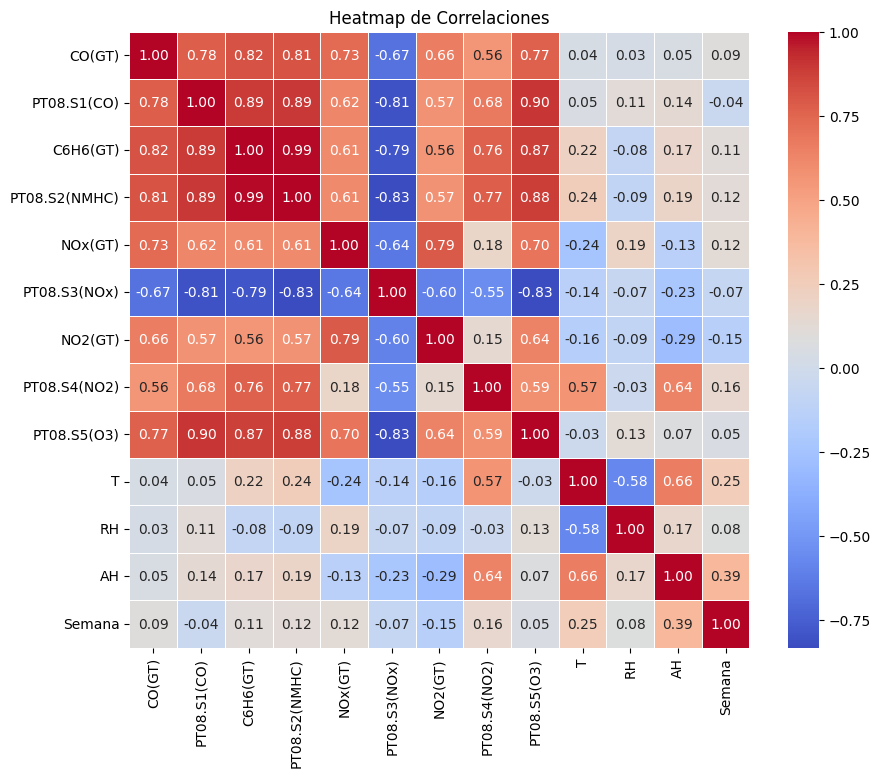

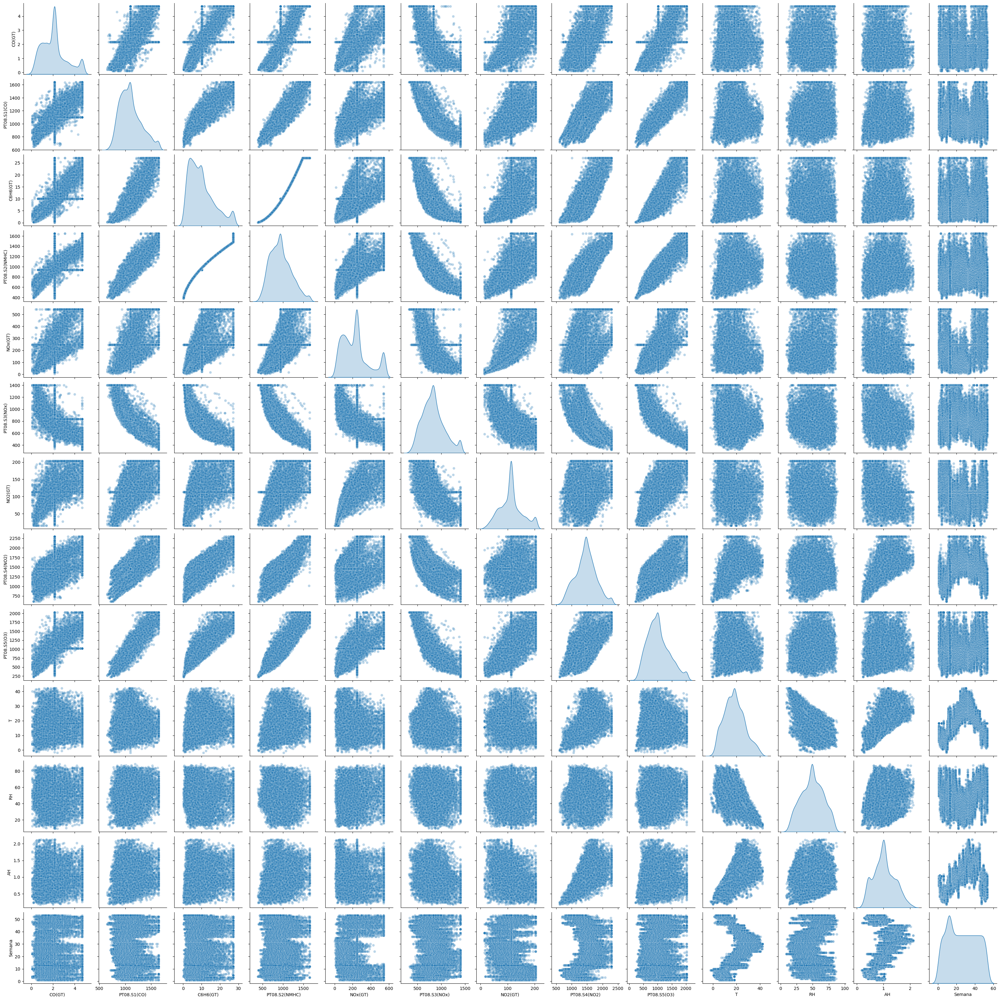

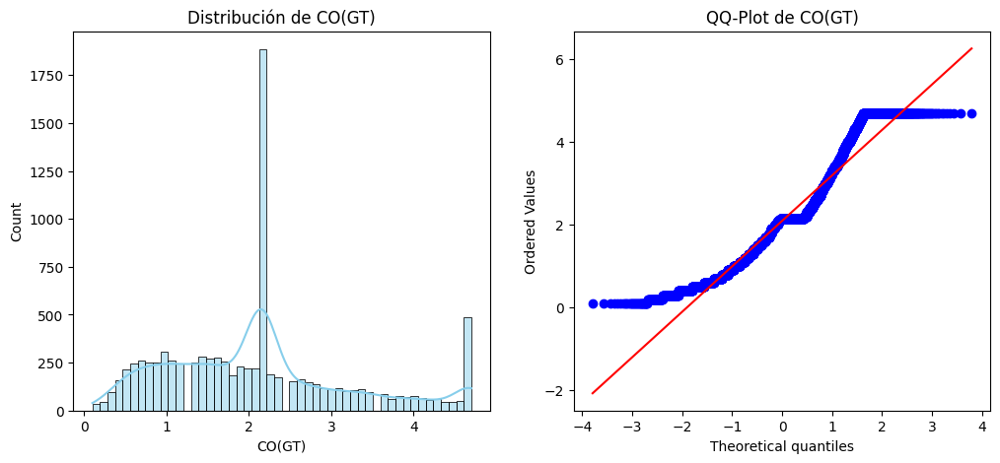


Pruebas de normalidad para la columna: CO(GT)
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 166.61344
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


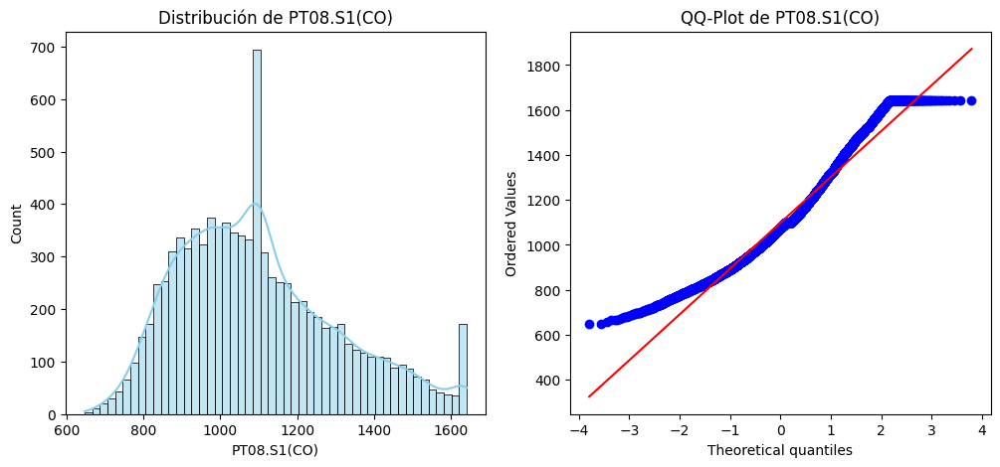


Pruebas de normalidad para la columna: PT08.S1(CO)
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 90.32940
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


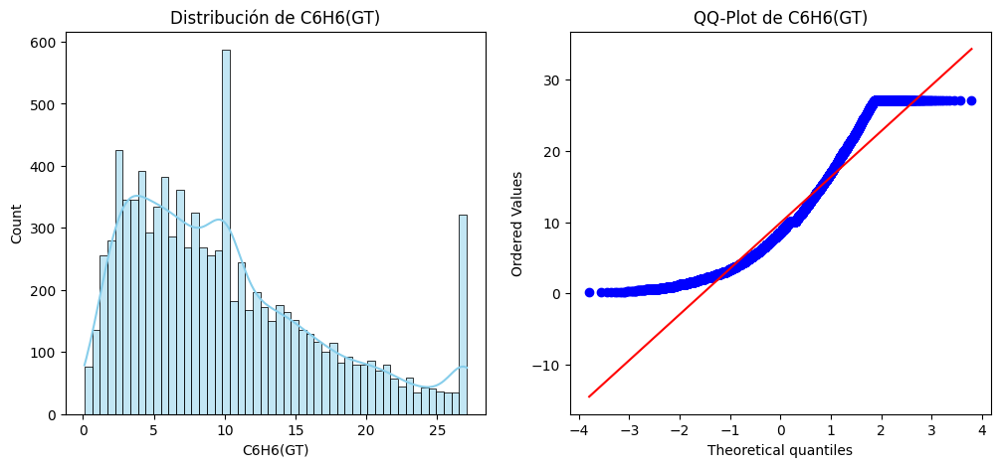


Pruebas de normalidad para la columna: C6H6(GT)
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 199.80237
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


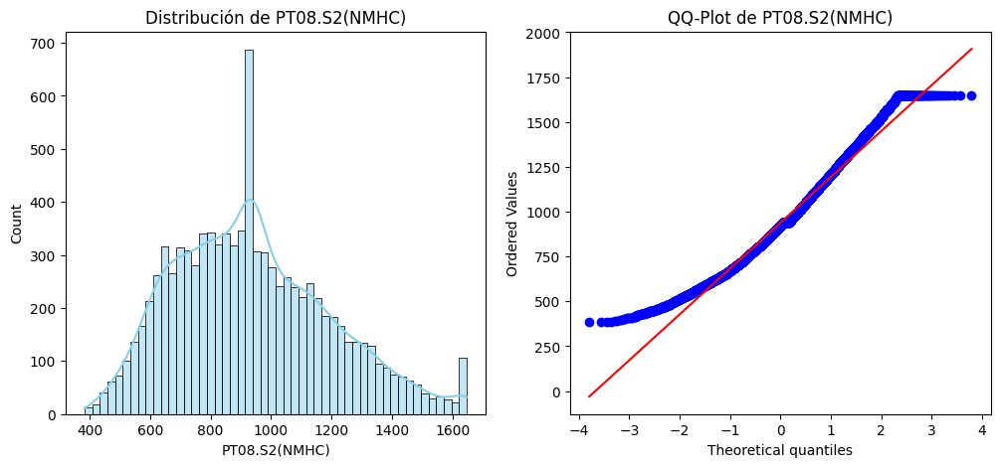


Pruebas de normalidad para la columna: PT08.S2(NMHC)
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 44.95367
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


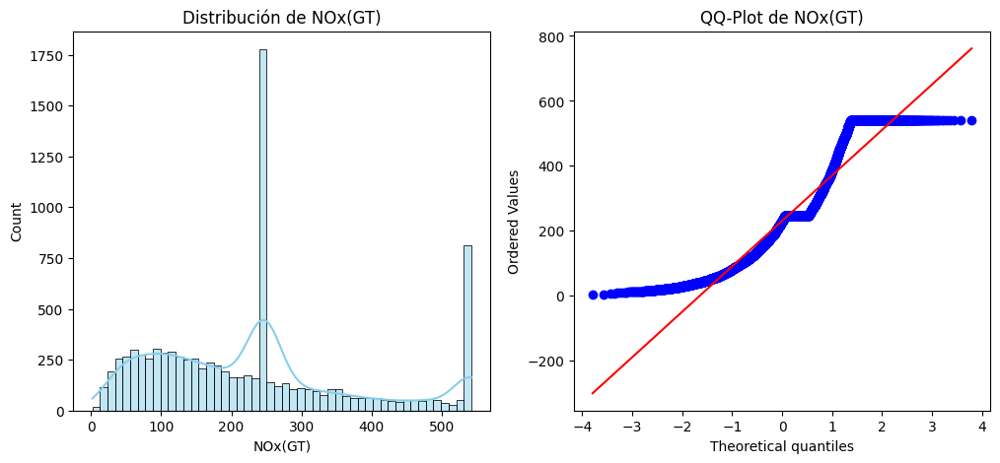


Pruebas de normalidad para la columna: NOx(GT)
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 237.69257
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


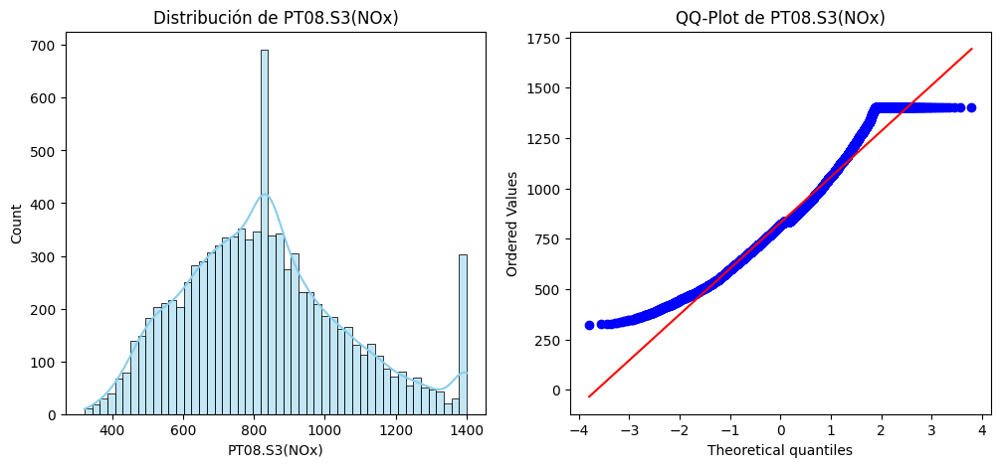


Pruebas de normalidad para la columna: PT08.S3(NOx)
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 50.95555
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


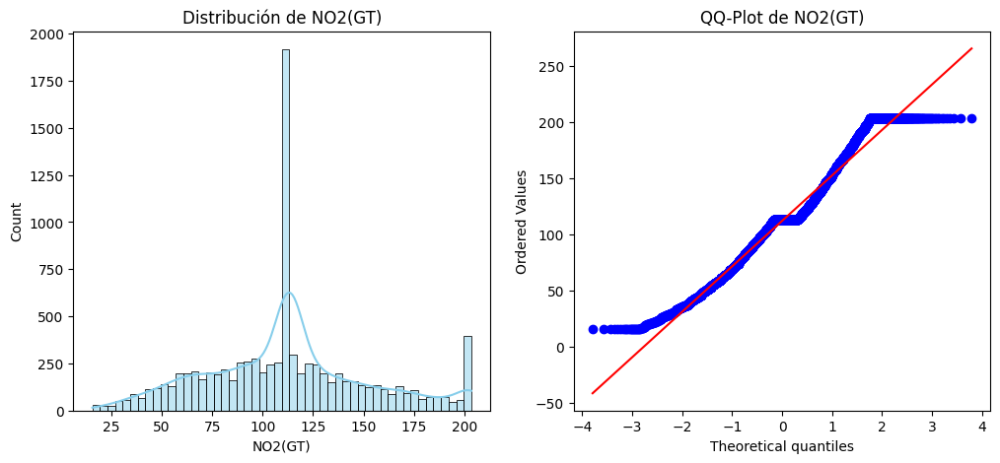


Pruebas de normalidad para la columna: NO2(GT)
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 94.68034
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


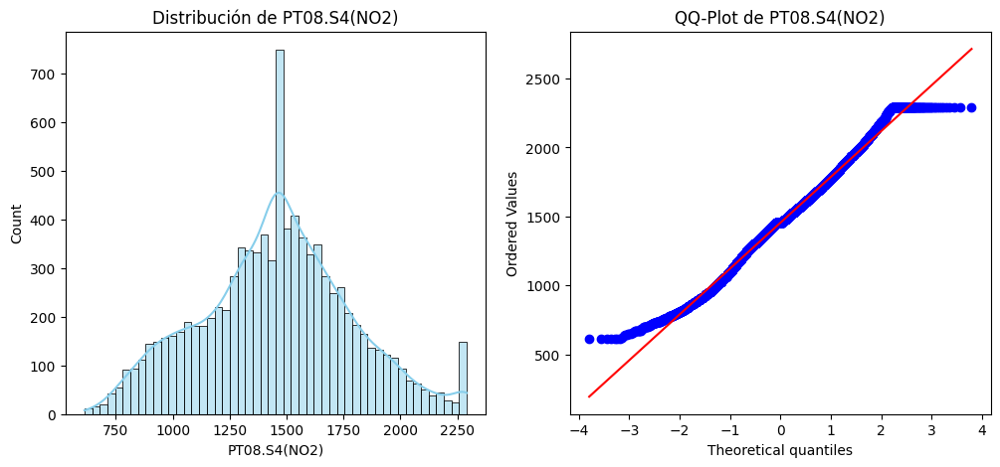


Pruebas de normalidad para la columna: PT08.S4(NO2)
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 12.86795
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


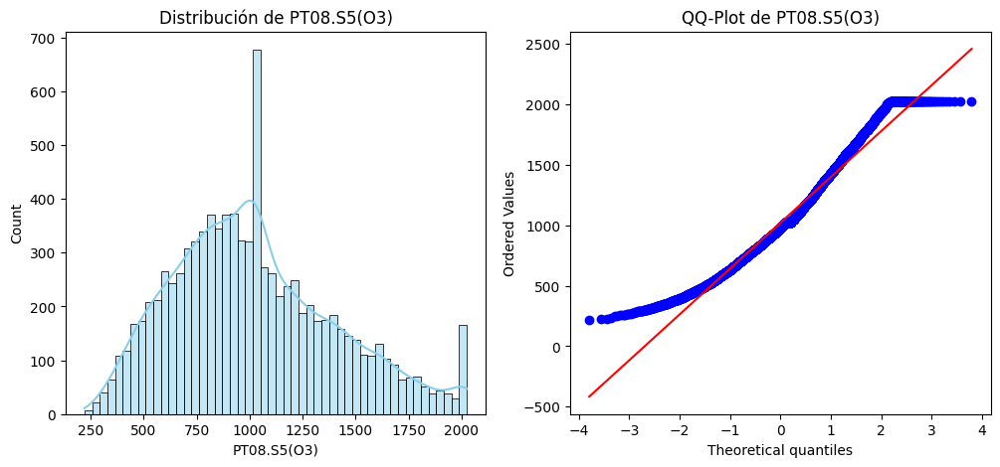


Pruebas de normalidad para la columna: PT08.S5(O3)
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 63.96348
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


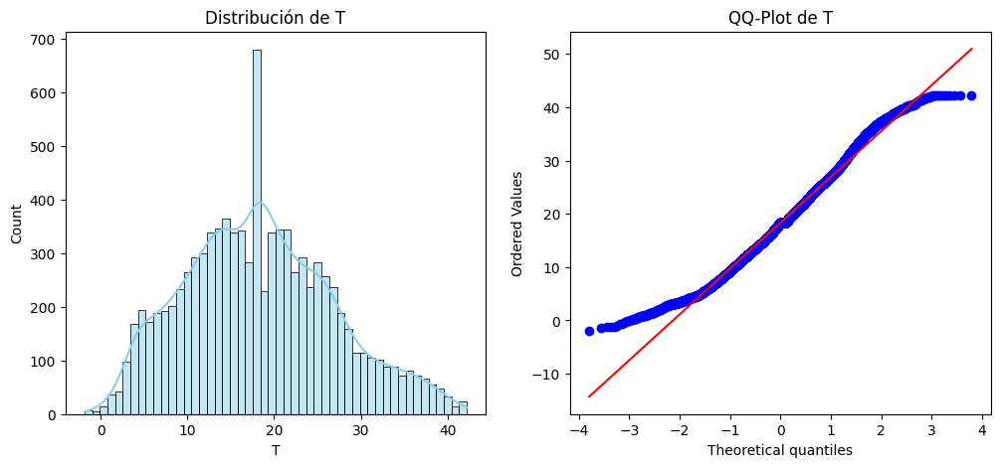


Pruebas de normalidad para la columna: T
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 20.88086
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


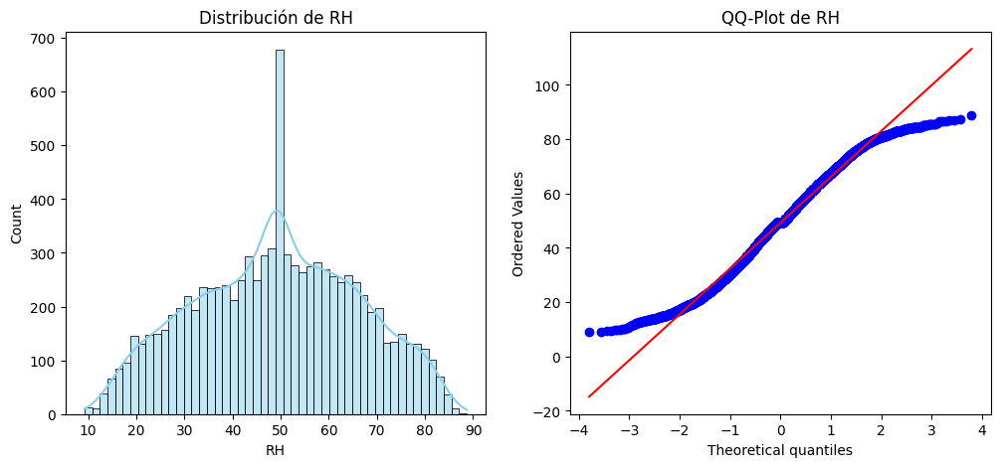


Pruebas de normalidad para la columna: RH
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 20.45099
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


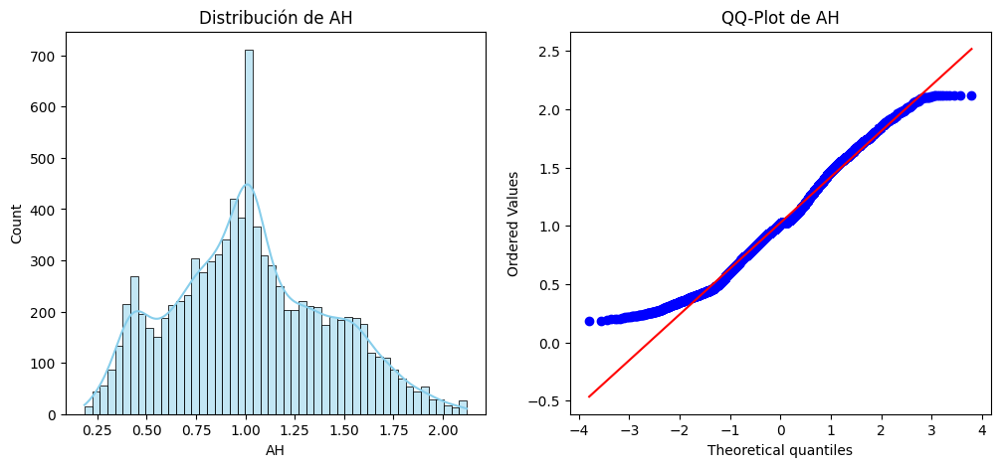


Pruebas de normalidad para la columna: AH
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 28.78701
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


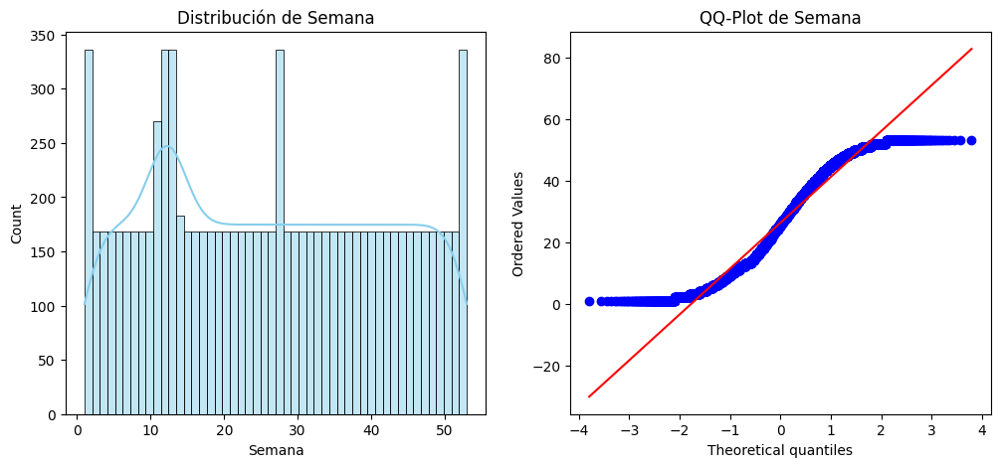


Pruebas de normalidad para la columna: Semana
Shapiro-Wilk Test: p-valor = 0.00000
Kolmogorov-Smirnov Test: p-valor = 0.00000
Anderson-Darling Test: Estadístico = 124.17234
  Al nivel de significancia 15.0%, los datos NO parecen normales.
  Al nivel de significancia 10.0%, los datos NO parecen normales.
  Al nivel de significancia 5.0%, los datos NO parecen normales.
  Al nivel de significancia 2.5%, los datos NO parecen normales.
  Al nivel de significancia 1.0%, los datos NO parecen normales.
D'Agostino-Pearson Test: p-valor = 0.00000


In [158]:
df.select_dtypes(include  = "number").describe()

import matplotlib.pyplot as plt
import seaborn as sns
# Selección de columnas númericas
columnas_numericas =  df.select_dtypes(include  = "number").columns

# Creación de histogramas para cada columna
plt.figure(figsize =  (12, 10))
for i, col in enumerate(columnas_numericas , 1):
    plt.subplot(4, 4, i)
    sns.histplot(df[col], kde =  False, bins =  30, color  = "skyblue")
    plt.title(f"Histograma de {col}", fontsize =  12)
    plt.xlabel(col, fontsize =  10)
    plt.ylabel("Frecuencia", fontsize =  14)

plt.tight_layout()
plt.show()

# Obtención del día de la semana
import seaborn as sns
df["Semana"] =  df["DateTime"].dt.isocalendar().week
plt.figure(figsize =  (18, 6))
sns.countplot(x = "Semana", data  =  df, palette =  "viridis")
plt.title("Frencuencia de Semanas Calidad del Aire")
plt.xlabel("Frecuencia")

num_cols  =  df.select_dtypes(include  =  "number").columns
plt.figure(figsize =  (15, 15))

# Creación de boxplots por columna
for i, col in enumerate(num_cols, 1):
    plt.subplot(3, 5, i)
    sns.boxplot(x =  df[col])
    plt.title(f"Boxplot de {col}")
plt.tight_layout()
plt.show()



num_cols =  df.select_dtypes(include  = "number")

# Matriz de correlaciones
corr_matrix =  num_cols.corr()

#
print("---Matriz de Correlaciones---")
print(corr_matrix)


# Visualizar la matriz de correlación con un heatmap
plt.figure(figsize =  (10, 8))
sns.heatmap(corr_matrix, annot = True, cmap =  "coolwarm",  fmt = ".2f", linewidth =  0.5)
plt.title("Heatmap de Correlaciones")
plt.show()






num_cols  =  df.select_dtypes(include = "number")
sns.pairplot(num_cols, plot_kws = {'alpha': 0.3}, diag_kind = 'kde')
plt.show()



import scipy.stats as stats
import numpy as np

numeric_columns  =  df.select_dtypes(include  = "number")

# Función para realizar pruebas de normalidad
def normality_tests(data, column_name):
    print(f"\nPruebas de normalidad para la columna: {column_name}")

    # Prueba de Shapiro-Wilk
    shapiro_test = stats.shapiro(data.sample(min(5000, len(data)), random_state=42))  # Muestra de 5000 para evitar problemas de cómputo
    print(f"Shapiro-Wilk Test: p-valor = {shapiro_test.pvalue:.5f}")

    # Prueba de Kolmogorov-Smirnov
    ks_test = stats.kstest(data, 'norm', args=(data.mean(), data.std()))
    print(f"Kolmogorov-Smirnov Test: p-valor = {ks_test.pvalue:.5f}")

    # Prueba de Anderson-Darling
    anderson_test = stats.anderson(data, dist='norm')
    print(f"Anderson-Darling Test: Estadístico = {anderson_test.statistic:.5f}")
    for i in range(len(anderson_test.critical_values)):
        sl, cv = anderson_test.significance_level[i], anderson_test.critical_values[i]
        if anderson_test.statistic < cv:
            print(f"  Al nivel de significancia {sl}%, los datos parecen normales.")
        else:
            print(f"  Al nivel de significancia {sl}%, los datos NO parecen normales.")

    # Prueba de D'Agostino-Pearson
    dagostino_test = stats.normaltest(data)
    print(f"D'Agostino-Pearson Test: p-valor = {dagostino_test.pvalue:.5f}")

# Función para graficar histograma y QQ-Plot
def plot_distribution(data, column_name):
    plt.figure(figsize=(12, 5))

    # Histograma
    plt.subplot(1, 2, 1)
    sns.histplot(data, bins=50, kde=True, color="skyblue")
    plt.title(f"Distribución de {column_name}")

    # QQ-Plot
    plt.subplot(1, 2, 2)
    stats.probplot(data, dist="norm", plot=plt)
    plt.title(f"QQ-Plot de {column_name}")

    plt.show()

# Aplicar pruebas de normalidad y gráficos a cada columna numérica
for column in numeric_columns:
    data = df[column]
    plot_distribution(data, column)
    normality_tests(data, column)